# Load stimuli
Add stimuli to Drive:
[lexamb-stimuli.zip](https://drive.google.com/file/d/15SMDf2MXthPZhDvWgfzh84-n8JLCPYSN/view?usp=sharing)

Mount Drive:

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Load models

In [ ]:
%%capture
!pip install transformers praat-parselmouth

In [ ]:
from transformers import pipeline
import IPython.display as ipd
from IPython.display import Audio
import parselmouth as pm
import glob

In [ ]:
w2v_b_asr = pipeline("automatic-speech-recognition", model="facebook/wav2vec2-base-960h")

### For experimentation with other models, add these models to "pipelines":
# w2v_l_asr = pipeline("automatic-speech-recognition", model="facebook/wav2vec2-large-960h")
# hub_l_asr = pipeline("automatic-speech-recognition", model="facebook/hubert-large-ls960-ft")
# hub_xl_asr = pipeline("automatic-speech-recognition", model="facebook/hubert-xlarge-ls960-ft")
# whis_b_asr = pipeline("automatic-speech-recognition", model="openai/whisper-base")

pipelines = [w2v_b_asr]

config.json:   0%|          | 0.00/1.60k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

Some weights of the model checkpoint at facebook/wav2vec2-base-960h were not used when initializing Wav2Vec2ForCTC: ['wav2vec2.encoder.pos_conv_embed.conv.weight_g', 'wav2vec2.encoder.pos_conv_embed.conv.weight_v']
- This IS expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'wav2vec2.masked_spec_embed', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original1']
You sho

tokenizer_config.json:   0%|          | 0.00/163 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/291 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/85.0 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/159 [00:00<?, ?B/s]

#Get transcriptions for lexical ambiguity stimuli (based on Gaskell et al. (2001))

In [ ]:
def transcribe(pipelines, viability, context, writing_mode='a', write_header=False):
  file_dir = f'drive/MyDrive/lexamb-stimuli/{viability}/{context}_context'
  stim_files = sorted(glob.glob(f'{file_dir}/*.wav'))
  with open('lexamb-transcriptions.csv', writing_mode) as outfile:
    if write_header:
      outfile.write('condition' + ',' + 'viability' + ',' + 'stimulus' + ',' + 'model' + ',' + 'transcription' + '\n')
    for file in stim_files:
      print(file.split('/')[-1])
      sound = pm.Sound(file) #.resample(resample_freq)
      ipd.display(Audio(sound.values, rate=sound.sampling_frequency))
      for pipe in pipelines:
        transcription = pipe({'sampling_rate': sound.sampling_frequency, 'raw':sound.values.flatten()})['text']
        print(f'{pipe.model.config._name_or_path.split("/")[-1]}: {transcription}')
        outfile.write(f'{context}-context' +
                      ',' +
                      f'{viability}' +
                      ',' +
                      f'{file.split("/")[-1]}'
                      + ',' +
                      f'{pipe.model.config._name_or_path.split("/")[-1]}'
                      + ',' +
                      f'{transcription}' +
                      '\n')
    print('')

In [ ]:
transcribe(pipelines, 'viable', 'biasing', writing_mode='w', write_header=True)
transcribe(pipelines, 'viable', 'silence')
transcribe(pipelines, 'viable', 'random')
transcribe(pipelines, 'unviable', 'biasing')
transcribe(pipelines, 'unviable', 'silence')
transcribe(pipelines, 'unviable', 'random')

#Get transcriptions for stimuli from Darcy et al. (2009)

In [ ]:
# clean, tan, own, lean, thin
target_stimuli = ['A1', 'A4', 'A3', 'A5', 'A8']
target_files = []
for target in target_stimuli:
  for file in glob.glob(f"drive/MyDrive/assimilation/stimA/{target}Pn*"):
    if not file.endswith('(1).wav'):
      target_files.append(file)

# green, plain, fun --> greeng, plaing, fung
target_stimuli = ['A2', 'A6', 'A7']
for target in target_stimuli:
  for file in glob.glob(f"drive/MyDrive/assimilation/stimA/{target}Pn*"):
    if not file.endswith('(1).wav'):
      target_files.append(file)

# great, sweet --> greak, sweek
target_stimuli = ['A6', 'A8']
for target in target_stimuli:
  for file in glob.glob(f"drive/MyDrive/assimilation/stimA/{target}Pt*"):
    if not file.endswith('(1).wav'):
      target_files.append(file)

# fat, wet --> fap, wep (A5, A7)
target_stimuli = ['A5', 'A7']
for target in target_stimuli:
  for file in glob.glob(f"drive/MyDrive/assimilation/stimA/{target}Pt*"):
    if not file.endswith('(1).wav') and not file.endswith('(2).wav'):
      target_files.append(file)

# mad, sad, bad --> mab, sab, bab
target_stimuli = ['A1', 'A2', 'A4']
for target in target_stimuli:
  for file in glob.glob(f"drive/MyDrive/assimilation/stimA/{target}Pd*"):
    if not file.endswith('(1).wav'):
      target_files.append(file)

# red --> reg
target_stimuli = ['A3']
for target in target_stimuli:
  for file in glob.glob(f"drive/MyDrive/assimilation/stimA/{target}Pd*"):
    if not file.endswith('(1).wav'):
      target_files.append(file)

target_files = sorted(target_files)
print(len(target_files))

144


In [ ]:
with open('viable-vs-unviable-transcriptions.csv', 'w') as outfile:
  for file in target_files:
    print(file.split('/')[-1])
    condition = file.split('/')[-1][5]
    print(condition)
    sound = pm.Sound(file) #.resample(resample_freq)
    ipd.display(Audio(sound.values, rate=sound.sampling_frequency))
    for pipe in pipelines:
      transcription = pipe({'sampling_rate': sound.sampling_frequency, 'raw':sound.values.flatten()})['text']
      print(f'{pipe.model.config._name_or_path.split("/")[-1]}: {transcription}')
      outfile.write(f'{condition}' +
                    ',' +
                    f'{file.split("/")[-1]}'
                    + ',' +
                    f'{pipe.model.config._name_or_path.split("/")[-1]}'
                    + ',' +
                    f'{transcription.replace(",", "")}' +
                    '\n')
    print('')

A1Pd1A10.wav
A


wav2vec2-base-960h: I DON'T WANT TO GO HOME TO FACE MY MAD BROTHER
wav2vec2-large-960h: I DON'T WANT TO GO HOME TO FACE MY MAD BROTHER
hubert-large-ls960-ft: I DON'T WANT TO GO HOME TO FACE MY MAD BROTHER
hubert-xlarge-ls960-ft: I DON'T WANT TO GO HOME TO FACE MY MAD BROTHER
whisper-base:  I don't want to go home to face my mom, brother.

A1Pd1C10.wav
C


wav2vec2-base-960h: I DON'T WANT TO GO HOME TO FACE MY MAPP DAUGHTER
wav2vec2-large-960h: I DON'T WANT TO GO HOME TO FACE MY MAB DAUGHTER
hubert-large-ls960-ft: I DON'T WANT TO GO HOME TO FACE MY MAB DAUGHTER
hubert-xlarge-ls960-ft: I DON'T WANT TO GO HOME TO FACE MY MAB DAUGHTER
whisper-base:  I don't want to go home to face my ma'am daughter.

A1Pd1I10.wav
I


wav2vec2-base-960h: I DON'T WANT TO GO HOME TO FACE MY MAD MOTHER
wav2vec2-large-960h: I DON'T WANT TO GO HOME TO FACE MY MADMOTHER
hubert-large-ls960-ft: I DON'T WANT TO GO HOME TO FACE MY MAD MOTHER
hubert-xlarge-ls960-ft: IDON'T WANT TO GO HOME TO FACE MY MAD MOTHER
whisper-base:  I don't want to go home to face my mad mother.

A1Pd2A14.wav
A


wav2vec2-base-960h: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAD BROTHER
wav2vec2-large-960h: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAD BROTHER
hubert-large-ls960-ft: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAD BROTHER
hubert-xlarge-ls960-ft: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAD BROTHER
whisper-base:  After crashing the family car, I had a very mad brother.

A1Pd2C14.wav
C


wav2vec2-base-960h: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAB DAUGHTER
wav2vec2-large-960h: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAB DAUGHTER
hubert-large-ls960-ft: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAB DAUGHTER
hubert-xlarge-ls960-ft: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAB DAUGHTER
whisper-base:  After crashing the family car, I had a very mad daughter.

A1Pd2I14.wav
I


wav2vec2-base-960h: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAD MOTHER
wav2vec2-large-960h: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAD MOTHER
hubert-large-ls960-ft: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAD MOTHER
hubert-xlarge-ls960-ft: AFTER CRASHING THE FAMILY CAR I HAD A VERY MAD MOTHER
whisper-base:  After crashing the family car, I had a very mad mother.

A1Pd3A7.wav
A


wav2vec2-base-960h: IT'S AWFUL MY CRANKY MAD BROTHER YELLS ALL THE TIME
wav2vec2-large-960h: IT'S AWFUL MY CRANKY MAD BROTHER YELLS ALL THE TIME
hubert-large-ls960-ft: IT'S AWFUL MY CRANKY MAD BROTHER YELLS ALL THE TIME
hubert-xlarge-ls960-ft: IT'S AWFUL MY CRANKY MAD BROTHER YELLS ALL THE TIME
whisper-base:  It's awful. My cranky-map brother yells all the time.

A1Pd3C7.wav
C


wav2vec2-base-960h: IT'S AWFUL MY CRANKY MAB DAUGHTER YELLS ALL THE TIME
wav2vec2-large-960h: IT'S AWFUL MY CRANKY MAB DAUGHTER YELLS ALL THE TIME
hubert-large-ls960-ft: IT'S AWFUL MY CRANKY MAB DAUGHTER YELLS ALL THE TIME
hubert-xlarge-ls960-ft: IT'S AWFUL MY CRANKY MAB DAUGHTER YELLS ALL THE TIME
whisper-base:  It's awful, my cranky-map daughter yells all the time.

A1Pd3I7.wav
I


wav2vec2-base-960h: IT'S AWFUL MY CRANKY MAD MOTHER YELLS ALL THE TIME
wav2vec2-large-960h: IT'S AWFUL MY CRANKY MADMOTHER YELLS ALL THE TIME
hubert-large-ls960-ft: IT'S AWFUL MY CRANKY MAD MOTHER YELLS ALL THE TIME
hubert-xlarge-ls960-ft: IT'S AWFUL MY CRANKY MAD MOTHER YELLS ALL THE TIME
whisper-base:  It's awful, my cranky-mad mother yells all the time.

A1Pn1A9.wav
A


wav2vec2-base-960h: PLEASE SARAH CAN YOU HAND ME A CLEAN PAN
wav2vec2-large-960h: PLEASE SARA CAN YOU HAND ME A CLEAN PAN
hubert-large-ls960-ft: PLEASE SARAH CAN YOU HAND ME A CLEAN PAN
hubert-xlarge-ls960-ft: PLEASE SARA CAN YOU HAND ME A CLEAN PAN
whisper-base:  Please Sarah, can you hand me a clean pan?

A1Pn1C9.wav
C


wav2vec2-base-960h: PLEASE SARAH CAN YOU HAND ME A CLEAN SPOON
wav2vec2-large-960h: PLEASE SARAH CAN YOU HAND ME A CLEAM SPOON
hubert-large-ls960-ft: PLEASE SARAH CAN YOU HAND ME A CLEAN SPOON
hubert-xlarge-ls960-ft: PLEASE SARA CAN YOU HAND ME A CLEAN SPOON
whisper-base:  Please Sarah, can you hand me a clean spoon?

A1Pn1I9.wav
I


wav2vec2-base-960h: PLEASE SARAH CAN YOU HAND ME A CLEAN FORK
wav2vec2-large-960h: PLEASE SARAH CAN YOU HAND ME A CLEAN FORK
hubert-large-ls960-ft: PLEASE SARA CAN YOU HAND ME A CLEAN FORK
hubert-xlarge-ls960-ft: PLEASE SARA CAN YOU HAND ME A CLEAN FORK
whisper-base:  Please Sarah, can you hand me a clean fork?

A1Pn2A4.wav
A


wav2vec2-base-960h: I'M OUT OF CLEAN PAN SO I SHOULD DO THE DISHES
wav2vec2-large-960h: I'M OUT OF CLEAN PANS SO I SHOULD DO THE DISHES
hubert-large-ls960-ft: I'M OUT OF CLEAN PANS SO I SHOULD DO THE DISHES
hubert-xlarge-ls960-ft: I'M OUT OF CLEAN PANS SO I SHOULD DO THE DISHES
whisper-base:  I'm out of clean pan so I should do the dishes.

A1Pn2C4.wav
C


wav2vec2-base-960h: AM OUT OF CLEAN SPOONS SO I SHOULD DO THE DISHES
wav2vec2-large-960h: 'M OUT OF CLEAN SPOONS SO I SHOULD DO THE DISHES
hubert-large-ls960-ft: OUT OF CLEAND SPOONS SO I SHOULD DO THE DISHES
hubert-xlarge-ls960-ft: A OUT OF CLEAND SPOONS SO I SHOULD DO THE DISHES
whisper-base:  a mat of clean spoons so I should do the dishes.

A1Pn2I4.wav
I


wav2vec2-base-960h: I'M OUT OF CLEAN FORKS SO I SHOULD DO THE DISHES
wav2vec2-large-960h: I'M OUT OF CLEAN FORKS SO I SHOULD DO THE DISHES
hubert-large-ls960-ft: I'M OUT OF CLEAN FORKS SO I SHOULD DO THE DISHES
hubert-xlarge-ls960-ft: 'M OUT OF CLEAN FORKS SO I SHOULD DO THE DISHES
whisper-base:  I'm out of clean forks, so I should do the dishes.

A1Pn3A6.wav
A


wav2vec2-base-960h: I'M LOOKING FOR A CLEAN PAN IN THIS KITCHEN BUT I CAN'T FIND ONE
wav2vec2-large-960h: I'M LOOKING FOR A CLEAN PAN IN THIS KITCHEN BUT I CAN'T FIND ONE
hubert-large-ls960-ft: I'M LOOKING FOR A CLEAN PAN IN THIS KITCHEN BUT I CAN'T FIND ONE
hubert-xlarge-ls960-ft: I'M LOOKING FOR A CLEAN PAN IN THIS KITCHEN BUT I CAN'T FIND ONE
whisper-base:  I'm looking for a clean pan in this kitchen, but I can't find one.

A1Pn3C6.wav
C


wav2vec2-base-960h: I'M LOOKING FOR A CLEAN SPOON IN THIS KITCHEN BUT I CAN'T FIND ONE
wav2vec2-large-960h: I'M LOOKING FOR A CLEAN SPOON IN THIS KITCHEN BUT I CAN'T FIND ONE
hubert-large-ls960-ft: I'M LOOKING FOR A CLEAN SPOON IN THIS KITCHEN BUT I CAN'T FIND ONE
hubert-xlarge-ls960-ft: I'M LOOKING FOR A CLEAN SPOON IN THIS KITCHEN BUT I CAN'T FIND ONE
whisper-base:  I'm looking for a clean spoon in this kitchen, but I can't find one.

A1Pn3I6.wav
I


wav2vec2-base-960h: I'M LOOKING FOR A CLEAN FORK IN THIS KITCHEN BUT I CAN'T FIND ONE
wav2vec2-large-960h: I'M LOOKING FOR A CLEAN FORK IN THIS KITCHEN BUT I CAN'T FIND ONE
hubert-large-ls960-ft: I'M LOOKING FOR A CLEAN FORK IN THIS KITCHEN BUT I CAN'T FIND ONE
hubert-xlarge-ls960-ft: I'M LOOKING FOR A CLEAN FORK IN THIS KITCHEN BUT I CAN'T FIND ONE
whisper-base:  I'm looking for a clean fork in this kitchen, but I can't find one.

A2Pd1A7.wav
A


wav2vec2-base-960h: SHE'S WRITTEN AT LEAST ONE SAB BALET IN HER LIFE
wav2vec2-large-960h: SHE'S WRITTEN AT LEAST ONE SAD BALLET IN HER LIFE
hubert-large-ls960-ft: SHE'S WRITTEN AT LEAST ONE SAD BALLET IN HER LIFE
hubert-xlarge-ls960-ft: SHE'S WRITTEN AT LEAST ONE SAD BALLET IN HER LIFE
whisper-base:  She's written at least one sad ballet in her life.

A2Pd1C7.wav
C


wav2vec2-base-960h: SHE HAS WRITTEN AT LEAST ONE SAB NOVEL IN HER LIFE
wav2vec2-large-960h: SHE'S WRITTEN AT LEAST ONE SAB NOVEL IN HER LIFE
hubert-large-ls960-ft: SHE'S WRITTEN AT LEAST ONE SAP NOVEL IN HER LIFE
hubert-xlarge-ls960-ft: SHE'S WRITTEN AT LEAST ONE SAD NOVEL IN HER LIFE
whisper-base:  She's written at least one sap novel in her life.

A2Pd1I7.wav
I


wav2vec2-base-960h: SHE'S WRITTEN AT LEAST ONE SAD MOVI IN HER LIFE
wav2vec2-large-960h: SHE'S WRITTEN AT LEAST ONE SAD MOVIE IN HER LIFE
hubert-large-ls960-ft: SHE'S RIDDEN AT LEAST ONE SAD MOVE IN HER LIFE
hubert-xlarge-ls960-ft: SHE'S WRITTEN AT LEAST ONE SAD MOVY IN HER LIFE
whisper-base:  She's written at least one sad movie in her life.

A2Pd2A2.wav
A


wav2vec2-base-960h: THIS SAB BALLET IS AN AMERICAN CLASSIC
wav2vec2-large-960h: THIS SAD BALLET IS AN AMERICAN CLASSIC
hubert-large-ls960-ft: THIS SABBALLET IS AN AMERICAN CLASSIC
hubert-xlarge-ls960-ft: THIS SAD BALLET IS AN AMERICAN CLASSIC
whisper-base:  This at Bel A is an American classic.

A2Pd2C2.wav
C


wav2vec2-base-960h: THIS ABNOVEL IS IN AMERICAN CLASSIC
wav2vec2-large-960h: THIS ABNOVEL IS AN AMERICAN CLASSIC
hubert-large-ls960-ft: THIS AB NOVEL IS AN AMERICAN CLASSIC
hubert-xlarge-ls960-ft: THIS SAB NOVEL IS AN AMERICAN CLASSIC
whisper-base:  this sub novel is an American classic.

A2Pd2I2.wav
I


wav2vec2-base-960h: THIS SAD MOVYE IS AN AMERICAN CLASSIC
wav2vec2-large-960h: THIS SAD MOVIE IS AN AMERICAN CLASSIC
hubert-large-ls960-ft: THIS SAD MOVIE IS AN AMERICAN CLASSIC
hubert-xlarge-ls960-ft: THIS SAD MOVY IS AN AMERICAN CLASSIC
whisper-base:  This sad movie is an American classic.

A2Pd3A3.wav
A


wav2vec2-base-960h: WHILE THE SAB BALET WON MANY AWARDS I DON'T LIKE IT
wav2vec2-large-960h: WHILE THE SAB BALLET WON MANY AWARDS I DON'T LIKE IT
hubert-large-ls960-ft: WHILE THE SAD BALLET WON MANY AWARDS I DON'T LIKE IT
hubert-xlarge-ls960-ft: WHILE THE SAD BALLET WON MANY AWARDS I DON'T LIKE IT
whisper-base:  While the Sab Ballet won many awards, I don't like it.

A2Pd3C3.wav
C


wav2vec2-base-960h: WHILE THE SAB NOVEL ONE MANY AWARDS I DON'T LIKE IT
wav2vec2-large-960h: WHILE THE SABNOVEL WONE MANY AWARDS I DON'T LIKE IT
hubert-large-ls960-ft: WHILE THE SAB NOVEL WON MANY AWARDS I DON'T LIKE IT
hubert-xlarge-ls960-ft: WHILE THE SAB NOVEL WON MANY AWARDS I DON'T LIKE IT
whisper-base:  While the SAB novel won many awards, I don't like it.

A2Pd3I3.wav
I


wav2vec2-base-960h: WHILE THE SAD MOVY ON MANY AWARDS I DON'T LIKE IT
wav2vec2-large-960h: WHILE THE SAD MOVY ONE MANY AWARDS I DON'T LIKE IT
hubert-large-ls960-ft: WHILE THE SAD MOVIE WON MANY A WARDS I DON'T LIKE IT
hubert-xlarge-ls960-ft: WHILE THE SAD MOVY WON MANY AWARDS I DON'T LIKE IT
whisper-base:  While the sad movie won many awards, I don't like it.

A2Pn1A5.wav
A


wav2vec2-base-960h: SHE BOUGHT THIS NEW GREEN CUP IN ANTUCKET LAST SUMMER
wav2vec2-large-960h: SHE BOUGHT THIS NEW GREEN CUP IN NAN TUCKET LAST SUMMER
hubert-large-ls960-ft: SHE BOUGHT THIS NEW GREEN CUP IN NANTUCKET LAST SUMMER
hubert-xlarge-ls960-ft: SHE BOUGHT THIS NEW GREEN CUP IN NANTUCKET LAST SUMMER
whisper-base:  She bought this new green cup in Antarctica last summer.

A2Pn1C5.wav
C


wav2vec2-base-960h: SHE BOUGHT THIS NEW GREEN CHAIR IN NANTUCKETT LAST SUMMER
wav2vec2-large-960h: SHE BOUGHT THIS NEW GREEN CHAIR IN NANTUCKET LAST SUMMER
hubert-large-ls960-ft: SHE BOUGHT THIS NEW GREEN CHAIR IN NANTUCKET LAST SUMMER
hubert-xlarge-ls960-ft: SHE BOUGHT THIS NEW GREEN CHAIR IN NANTUCKET LAST SUMMER
whisper-base:  She bought this new green chair and now took it last summer.

A2Pn1I5.wav
I


wav2vec2-base-960h: SHE BOUGHT THIS NEW GREEN VASE IN NANTUCKETT LAST SUMMER
wav2vec2-large-960h: SHE BOUGHT THIS NEW GREEN VASE IN NANTUCKET LAST SUMMER
hubert-large-ls960-ft: SHE BOUGHT THIS NEW GREEN VASE IN NANTUCKET LAST SUMMER
hubert-xlarge-ls960-ft: SHE BOUGHT THIS NEW GREEN VASE IN NANTUCKET LAST SUMMER
whisper-base:  She bought this new green vase in Antarctica last summer.

A2Pn2A8.wav
A


wav2vec2-base-960h: MY SUN BROKE MY NEIGHBOUR'S NEW GREEN CUP
wav2vec2-large-960h: MY SON BROKE MY NEIGHBOUR'S NEW GREEN CUP
hubert-large-ls960-ft: MY SON BROKE MY NEIGHBOUR'S NEW GREEN CUP
hubert-xlarge-ls960-ft: MY SON BROKE MY NEIGHBOUR'S NEW GREEN CUP
whisper-base:  My son broke my neighbor's new green cup.

A2Pn2C8.wav
C


wav2vec2-base-960h: MY SON BROKE MY NEIGHBOUR'S NEW GREEN CHAIR
wav2vec2-large-960h: MY SON BROKE MY NEIGHBOUR'S NEW GREEN CHAIR
hubert-large-ls960-ft: MY SON BROKE MY NEIGHBOUR'S NEW GREEN CHAIR
hubert-xlarge-ls960-ft: MY SON BROKE MY NEIGHBOUR'S NEW GREEN CHAIR
whisper-base:  My son broke my neighbor's new green chair.

A2Pn2I8.wav
I


wav2vec2-base-960h: MY SUN BROKE MY NEIGHBOUR'S NEW GREEN VASE
wav2vec2-large-960h: MY SON BROKE MY NEIGHBOUR'S NEW GREEN VASE
hubert-large-ls960-ft: MY SON BROKE MY NEIGHBOUR'S NEW GREEN VASE
hubert-xlarge-ls960-ft: MY SON BROKE MY NEIGHBOUR'S NEW GREEN VASE
whisper-base:  My son broke my neighbor's new green vase.

A2Pn3A8.wav
A


wav2vec2-base-960h: THE COLLAR OF THIS ANTIQUE GREEN CUP IS REALLY PRETTY
wav2vec2-large-960h: THE COLOR OF THIS ANTIQUE GREEN CUP IS REALLY PRETTY
hubert-large-ls960-ft: THE COLOUR OF THIS ANTIQUE GREEN CUP IS REALLY PRETTY
hubert-xlarge-ls960-ft: THECOLOR OF THIS ANTIQUE GREEN CUP IS REALLY PRETTY
whisper-base:  The color of this antique green cup is really pretty.

A2Pn3C8.wav
C


wav2vec2-base-960h: THE COLOR OF THIS ANTIQUE GREEN CHAIR IS REALLY PRETTY
wav2vec2-large-960h: THE COLLAR OF THIS ANTIQUE GREEN CHAIR IS REALLY PRETTY
hubert-large-ls960-ft: THE COLOUR OF THIS ANTIQUE GREEN CHAIR IS REALLY PRETTY
hubert-xlarge-ls960-ft: THE COLOR OF THIS ANTIQUEGREEN CHAIR IS REALLY PRETTY
whisper-base:  The color of the santae green chair is really pretty.

A2Pn3I8.wav
I


wav2vec2-base-960h: THE COLOR OF THIS ANTIQUE GREEN VASE IS REALLY PRETTY
wav2vec2-large-960h: THE COLOR OF THIS ANTIQUE GREEN VASE IS REALLY PRETTY
hubert-large-ls960-ft: THE COLOUR OF THIS ANTIQUE GREEN VASE IS REALLY PRETTY
hubert-xlarge-ls960-ft: THE COLOR OF THIS ANTIQUE GREEN VASE IS REALLY PRETTY
whisper-base:  The color of this antique green vase is really pretty.

A3Pd1A2.wav
A


wav2vec2-base-960h: THOSE RED GLASSES ADDA NICE TOUCH TO YOUR BLACK OUTFIT
wav2vec2-large-960h: THOSE RED GLASSES AD A NICE TOUCH TO YOUR BLACK OUTFIT
hubert-large-ls960-ft: THOSE RED GLASSES ADD A NICE TOUCH TO YOUR BLACK OUTFIT
hubert-xlarge-ls960-ft: THOSE RED GLASSES ADD A NICE TOUCH TO YOUR BLACK OUTFIT
whisper-base:  Those red glasses add a nice touch to your black outfit.

A3Pd1C2.wav
C


wav2vec2-base-960h: T REG LIP STICK AS A NICE TOUCH TO YOUR BLACK OUTFIT
wav2vec2-large-960h: THAT RAG LIPSTICK ADDS A NICE TOUCH TO YOUR BLACK OUTFIT
hubert-large-ls960-ft: THAT RAG LIPSTICK ADDS A NICE TOUCH TO YOUR BLACK OUTFIT
hubert-xlarge-ls960-ft: THAT RAG GLIPSTICK  ADDS A NICE TOUCH TO YOUR BLACK OUTFIT
whisper-base:  That rag lipstick adds a nice touch to your black outfit.

A3Pd1I2.wav
I


wav2vec2-base-960h: HAT RED NECKLACE AS A NICE TOUCHED YOUR BLACK OUTFIT
wav2vec2-large-960h: THAT RED NECKLACE ADDS A NICE TOUCH TO YOUR BLACK OUTFIT
hubert-large-ls960-ft: THAT RED NECKLACE ADDS A NICE TOUCH TO YOUR BLACK OUTFIT
hubert-xlarge-ls960-ft: THAT RED NECKLACE ADDS A NICE TOUCH TO YOUR BLACK OUTFIT
whisper-base:  That red necklace adds a nice touch to your black outfit.

A3Pd2A9.wav
A


wav2vec2-base-960h: YOU'RE TOO PALE TO WEAR THOSE FLASHY RED GLASSES
wav2vec2-large-960h: YOU'RE TOO PALE TO WEAR THOSE FLASHY RED GLASSES
hubert-large-ls960-ft: YOU'RE TOO PALE TO WEAR THOSE FLASHY RED GLASSES
hubert-xlarge-ls960-ft: YOU'RE TOO PALE TO WEAR THOSE FLASHY RED GLASSES
whisper-base:  You're too pale to wear those flashy red glasses.

A3Pd2C9.wav
C


wav2vec2-base-960h: YOU'RE TOO PALE TO WEAR THAT FLASHY REG LIPSTICK
wav2vec2-large-960h: YOU'RE TOO PALE TO WEAR THAT FLASHY RED LIPSTYCK
hubert-large-ls960-ft: YOU'RE TOO PALE TO WEAR THAT FLASHY RED GLIPSTICK
hubert-xlarge-ls960-ft: YOU'RE TOO PALE TO WEAR THAT FLASHY RED GLIPSTICK
whisper-base:  You're too pale to wear that flashy red glips deck.

A3Pd2I9.wav
I


wav2vec2-base-960h: YOU'RE TOO PALE TO WEAR THAT FLASHY RED NECKLACE
wav2vec2-large-960h: YOU'RE TOO PALE TO WEAR THAT FLASHY RED NECKLACE
hubert-large-ls960-ft: OU'RE TOO PALE TO WEAR THAT FLASHY RED NECKLACE
hubert-xlarge-ls960-ft: YOU'RE TOO PALE TO WEAR THAT FLASHY RED NECKLACE
whisper-base:  You're too pale to wear that flashy red necklace.

A3Pd3A8.wav
A


wav2vec2-base-960h: I ALREADY LOST MY NEW RED GLASSES THAT I JUST BOUGHT
wav2vec2-large-960h: I ALREADY LOST MY NEW RAG GLASSES THAT I JUST BOUGHT
hubert-large-ls960-ft: ALREADY LOST MY NEW RAG GLASSES THAT I JUST BOUGHT
hubert-xlarge-ls960-ft: ALREADY LOST MY NEW RAG GLASSES THAT I JUST BOUGHT
whisper-base:  I already lost my new red glasses that I just bought.

A3Pd3C8.wav
C


wav2vec2-base-960h: I ALREADY LOST MY NEW REGLIP STIC THAT I JUST BOUGHT
wav2vec2-large-960h: I ALREADY LOST MY NEW RED GLIPSTIC THAT I JUST BOUGHT
hubert-large-ls960-ft: I ALREADY LOST MY NEW RED GLIPSTICK THAT I JUST BOUGHT
hubert-xlarge-ls960-ft: I ALREADY LOST MY NEW REG GLIPSTICK THAT I JUST BOUGHT
whisper-base:  I already lost my new red glips stick that I just bought.

A3Pd3I8.wav
I


wav2vec2-base-960h: I ALREADY LOST WHEN YOU READ NECKLACE THAT I JUST BOUGHT
wav2vec2-large-960h: I ALREADY LOST MY NEW RED NECKLACE THAT I JUST BOUGHT
hubert-large-ls960-ft: ALREADY LOST MY NEW RED NECKLACE THAT I JUST BOUGHT
hubert-xlarge-ls960-ft: ALREADY LOST MY NEW RED NECKLACE THAT I JUST BOUGHT
whisper-base:  I already lost when you read necklace that I just bought.

A3Pn1A6.wav
A


wav2vec2-base-960h: THE COLLAR OF THAT TAM BELT IS REALLY UGLY
wav2vec2-large-960h: THE COLLOR OF THAT TAM BELT IS REALLY UGLY
hubert-large-ls960-ft: THE COLOUR OF THAT TAN BELT IS REALLY UGLY
hubert-xlarge-ls960-ft: THE COLOR OF THAT TAN BELT IS REALLY UGLY
whisper-base:  The color of that tan belt is really ugly.

A3Pn1C6.wav
C


wav2vec2-base-960h: THE COLOR OF THAT TAM'S SHIRT IS REALLY UGLY
wav2vec2-large-960h: THE COLOR OF THAT TAMMED SHIRT IS REALLY UGLY
hubert-large-ls960-ft: THE COLOUR OF THAT TAMD SHIRT IS REALLY UGLY
hubert-xlarge-ls960-ft: THE COLOR OF THAT TAME SHIRT IS REALLY UGLY
whisper-base:  The color of that tam shirt is really ugly.

A3Pn1I6.wav
I


wav2vec2-base-960h: THE COLLAR OF THAT TAN SCARF IS REALLY UGLY
wav2vec2-large-960h: THE COLOR OF THAT TANND SCARF IS REALLY UGLY
hubert-large-ls960-ft: THE COLOUR OF THAT TAN SCARF IS REALLY UGLY
hubert-xlarge-ls960-ft: THE COLOR OF THAT TANNE SCARF IS REALLY UGLY
whisper-base:  The color of that tan scarf is really ugly.

A3Pn2A9.wav
A


wav2vec2-base-960h: I BOUGHT A REALLY EXPENSIVE TAM BELT IN THAT STORE
wav2vec2-large-960h: I BOUGHT A REALLY EXPENSIVE TAN BELT IN THAT STORE
hubert-large-ls960-ft: I BOUGHT A REALLY EXPENSIVE TAN BELT IN THAT STORE
hubert-xlarge-ls960-ft: I BOUGHT A REALLY EXPENSIVE TAN BELT IN THAT STORE
whisper-base:  I bought a really expensive tam belt in that store.

A3Pn2C9.wav
C


wav2vec2-base-960h: I HAVE HOT A REALLY EXPENSIVE TAM SHIRT IN THAT STORE
wav2vec2-large-960h: I BOUGHT A REALLY EXPENSIVE TAMMED SHIRT IN THAT STORE
hubert-large-ls960-ft: I BOUGHT A REALLY EXPENSIVE TAN SHIRT IN THAT STORE
hubert-xlarge-ls960-ft: I BOUGHT A REALLY EXPENSIVE TAM SHIRT IN THAT STORE
whisper-base:  I've had a really expensive term shirt in that store.

A3Pn2I9.wav
I


wav2vec2-base-960h: I BOUGHT A REALLY EXPENSIVE TAN SCARF IN THAT STORE
wav2vec2-large-960h: I BOUGHT A REALLY EXPENSIVE TANND SCARF IN THAT STORE
hubert-large-ls960-ft: I BOUGHT A REALLY EXPENSIVE TAN SCARF IN THAT STORE
hubert-xlarge-ls960-ft: I BOUGHT A REALLY EXPENSIVE TAN SCARF IN THAT STORE
whisper-base:  I bought a really expensive tan scarf in that store.

A3Pn3A2.wav
A


wav2vec2-base-960h: MY TAM BELT WAS STOLEN IN THE LAUNDRY
wav2vec2-large-960h: MY TAN BELT WAS STOLEN IN THE LAUNDRY
hubert-large-ls960-ft: MY TAN BELT WAS STOLEN IN THE LAUNDRY
hubert-xlarge-ls960-ft: MY TAN BELT WAS STOLEN IN THE LAUNDRY
whisper-base:  My tampelt was stolen in the laundry.

A3Pn3C2.wav
C


wav2vec2-base-960h: MY TAMD SHIRT WAS STOLEN IN THE LAUNDRY
wav2vec2-large-960h: MY TAMMED SHIRT WAS STOLEN IN THE LAUNDRY
hubert-large-ls960-ft: MY TAM SHIRT WAS STOLEN IN THE LAUNDRY
hubert-xlarge-ls960-ft: MY TAMD SHIRT WAS STOLEN IN THE LAUNDRY
whisper-base:  My tamp shirt was stolen in the laundry.

A3Pn3I2.wav
I


wav2vec2-base-960h: MY TAN SCARF WAS STOLEN IN THE LAUNDRY
wav2vec2-large-960h: MY TANNED SCARF WAS STOLEN IN THE LAUNDRY
hubert-large-ls960-ft: MY TAN SCARF WAS STOLEN IN THE LAUNDRY
hubert-xlarge-ls960-ft: MY TAN SCARF WAS STOLEN IN THE LAUNDRY
whisper-base:  My tam scarfe is stolen in the laundry.

A4Pd1A13.wav
A


wav2vec2-base-960h: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD BEER THERE
wav2vec2-large-960h: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD BEER THERE
hubert-large-ls960-ft: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD BEER THERE
hubert-xlarge-ls960-ft: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD BEER THERE
whisper-base:  I'll never go back to this pub. I had such a bad beer there.

A4Pd1C13.wav
C


wav2vec2-base-960h: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAB LUNCH THERE
wav2vec2-large-960h: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAB LUNCH THERE
hubert-large-ls960-ft: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD LUNCH THERE
hubert-xlarge-ls960-ft: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD LUNCH THERE
whisper-base:  I'll never go back to this pub. I had such a bab lunch there.

A4Pd1I13.wav
I


wav2vec2-base-960h: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD DISH THERE
wav2vec2-large-960h: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD DISH THERE
hubert-large-ls960-ft: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD DISH THERE
hubert-xlarge-ls960-ft: I'LL NEVER GO BACK TO THIS PUB I HAD SUCH A BAD DISH THERE
whisper-base:  I'll never go back to this pub. I had such a bad dish there.

A4Pd2A16.wav
A


wav2vec2-base-960h: IT TASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD BEER
wav2vec2-large-960h: IT TASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD BEER
hubert-large-ls960-ft: IT TASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD BEER
hubert-xlarge-ls960-ft: IT TASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD BEER
whisper-base:  It tastes like it's been sitting out all night. This is a really bad beer.

A4Pd2C16.wav
C


wav2vec2-base-960h: IT TASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD LUNCH
wav2vec2-large-960h: IT TASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD LUNCH
hubert-large-ls960-ft: ITASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD LUNCH
hubert-xlarge-ls960-ft: ITTASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD LUNCH
whisper-base:  It tastes like it's been sitting out all night. This is a really bad lunch.

A4Pd2I16.wav
I


wav2vec2-base-960h: IT TASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD DISH
wav2vec2-large-960h: IT TASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD DISH
hubert-large-ls960-ft: TASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD DISH
hubert-xlarge-ls960-ft: ITASTES LIKE IT'S BEEN SITTING OUT ALL NIGHT THIS IS A REALLY BAD DISH
whisper-base:  It tastes like it's been sitting out all night. This is a really bad dish.

A4Pd3A13.wav
A


wav2vec2-base-960h: FOR SOMETHING SO EXPENSIVE THIS IS A REALLY BAD BEER
wav2vec2-large-960h: FOR SOMETHING SO EXPENSIVE THIS IS A REALLY BAD BEER
hubert-large-ls960-ft: ORSOMETHING SO EXPENSIVE THIS IS A REALLY BAD BEER
hubert-xlarge-ls960-ft: SOMETHING SO EXPENSIVE THIS IS A REALLY BAD BEER
whisper-base:  For something so expensive, this is a really bad beer.

A4Pd3C13.wav
C


wav2vec2-base-960h: OR SOMETHING SO EXPENSIVE THIS IS A REALLY BAD LUNCH
wav2vec2-large-960h: FOR SOMETHING SO EXPENSIVE THIS IS A REALLY BAD LUNCH
hubert-large-ls960-ft: FOR SOMETHING SO EXPENSIVE THIS IS A REALLY BAD LUNCH
hubert-xlarge-ls960-ft: RSOMETHING SO EXPENSIVE THIS IS A REALLY BAD LUNCH
whisper-base:  For something so expensive, this is a really bad lunch.

A4Pd3I13.wav
I


wav2vec2-base-960h: FOR SOMETHING SO EXPENSIVE THIS IS A REALLY BAD DISH
wav2vec2-large-960h: FOR SOMETHING SO EXPENSIVE THIS IS A REALLY BAD DISH
hubert-large-ls960-ft: SOMETHING SO EXPENSIVE THIS IS A REALLY BAD DISH
hubert-xlarge-ls960-ft: SOMETHING SO EXPENSIVE THIS IS A REALLY BAD DISH
whisper-base:  For something so expensive, this is a really bad dish.

A4Pn1A11.wav
A


wav2vec2-base-960h: I HAVE TO DECIDE BY MYSELF IT'S MY OWN PLAN
wav2vec2-large-960h: I HAVE TO DECIDE BY MYSELF IT'S MY OWN PLAN
hubert-large-ls960-ft: I HAVE TO DECIDE BY MYSELF IT'S MY OWN PLAN
hubert-xlarge-ls960-ft: I HAVE TO DECIDE BY MYSELF IT'S MY OWN PLAN
whisper-base:  I have to decide by myself. It's my own plan.

A4Pn1C11.wav
C


wav2vec2-base-960h: I HAVE TO DECIDE BY MYSELF IT'S MY OWN CHOICE
wav2vec2-large-960h: I HAVE TO DECIDE BY MYSELF IT'S MY OWN CHOICE
hubert-large-ls960-ft: I HAVE TO DECIDE BY MYSELF IT'S MY OWN CHOICE
hubert-xlarge-ls960-ft: I HAVE TO DECIDE BY MYSELF IT'S MY OWN CHOICE
whisper-base:  I have to decide by myself. It's my own choice.

A4Pn1I11.wav
I


wav2vec2-base-960h: I HAVE TO DECIDE BY MYSELF IT'S MY OWN LIFE
wav2vec2-large-960h: I HAVE TO DECIDE BY MYSELF IT'S MY OWN LIFE
hubert-large-ls960-ft: HAVE TO DECIDE BY MYSELF IT'S MY OWN LIFE
hubert-xlarge-ls960-ft: IHAVE TO DECIDE BY MYSELF IT'S MY OWN LIFE
whisper-base:  I have to decide by myself. It's my own life.

A4Pn2A3.wav
A


wav2vec2-base-960h: IT'S YOUR OWN PLAN YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
wav2vec2-large-960h: IT'S YOUR OWN PLAN YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
hubert-large-ls960-ft: IT'S YOUR OWN PLAN YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
hubert-xlarge-ls960-ft: IT'S YOUR OWN PLAN YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
whisper-base:  It's your own plan. You have to figure out what you want by yourself.

A4Pn2C3.wav
C


wav2vec2-base-960h: IT'S YOUR OWN CHOICE YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
wav2vec2-large-960h: IT'S YOUR OWN CHOICE YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
hubert-large-ls960-ft: IT'S YOUR OWN CHOICE YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
hubert-xlarge-ls960-ft: IT'S YOUR OWN CHOICE YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
whisper-base:  It's your own choice. You have to figure out what you want by yourself.

A4Pn2I3.wav
I


wav2vec2-base-960h: IT'S YOUR OWN LIFE YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
wav2vec2-large-960h: IT'S YOUR OWN LIFE YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
hubert-large-ls960-ft: IT'S YOUR OWN LIFE YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
hubert-xlarge-ls960-ft: IT'S YOUR OWN LIFE YOU HAVE TO FIGURE OUT WHAT YOU WANT BY YOURSELF
whisper-base:  It's your own life. You have to figure out what you want by yourself.

A4Pn3A3.wav
A


wav2vec2-base-960h: IT'S MY OWN PLAN I'LL DO WHAT I WANT
wav2vec2-large-960h: IT'S MY OWN PLAN I'LL DO WHAT I WANT
hubert-large-ls960-ft: IT'S MY OWN PLAN I'LL DO WHAT I WANT
hubert-xlarge-ls960-ft: IT'S MY OWN PLAN I'LL DO WHAT I WANT
whisper-base:  It's my own plan. I'll do what I want.

A4Pn3C3.wav
C


wav2vec2-base-960h: IT'S MY OWN CHOICE I'LL DO WHAT I WANT
wav2vec2-large-960h: IT'S MY OWN CHOICE I'LL DO WHAT I WANT
hubert-large-ls960-ft: IT'S MY OWN CHOICE I'LL DO WHAT I WANT
hubert-xlarge-ls960-ft: IT'S MY OWN CHOICE I'LL DO WHAT I WANT
whisper-base:  It's my own choice. I'll do what I want.

A4Pn3I3.wav
I


wav2vec2-base-960h: IT'S MY OWN LIFE I'LL DO WHAT I WANT
wav2vec2-large-960h: IT'S MY OWN LIFE I'LL DO WHAT I WANT
hubert-large-ls960-ft: IT'S MY OWN LIFE I'LL DO WHAT I WANT
hubert-xlarge-ls960-ft: IT'S MY OWN LIFE I'LL DO WHAT I WANT
whisper-base:  It's my own life. I'll do what I want.

A5Pn1A4.wav
A


wav2vec2-base-960h: HE SAW HER LEAN BACK IN THE DIM LIGHT
wav2vec2-large-960h: HE SAW HER LEAN BACK IN THE DIM LIGHT
hubert-large-ls960-ft: HE SAW HER LEAN BACK IN THE DIM LIGHT
hubert-xlarge-ls960-ft: HE SAW HER LEAN BACK IN THE DIM LIGHT
whisper-base:  He saw her lean back in the dim light.

A5Pn1C4.wav
C


wav2vec2-base-960h: HE SAW HER LEAM SHAPE IN THE DIM LIGHT
wav2vec2-large-960h: HE SAW HER LEAM SHAPE IN THE DIM LIGHT
hubert-large-ls960-ft: HE SAW HER LEAM SHAPE IN THE DIM LIGHT
hubert-xlarge-ls960-ft: HE SAW HER LEAN SHAPE IN THE DIM LIGHT
whisper-base:  He saw her lame shape in the dim light.

A5Pn1I4.wav
I


wav2vec2-base-960h: HE SAW HER LEAN LINE IN THE DIM LIGHT
wav2vec2-large-960h: HE SAW HER LEAN LINE IN THE DIM LIGHT
hubert-large-ls960-ft: HE SAW HER LEAN LINE IN THE DIM LIGHT
hubert-xlarge-ls960-ft: HE SAW HER LEAN LINE IN THE DIM LIGHT
whisper-base:  He saw her lean line in the dim light.

A5Pn2A7.wav
A


wav2vec2-base-960h: HE COULD DISTINGUISH HER LEAN BACK IN THE DARK ROOM
wav2vec2-large-960h: HE COULD DISTINGUISH HER LEAN BACK IN THE DARK ROOM
hubert-large-ls960-ft: HE COULD DISTINGUISH HER LEAN BACK IN THE DARK ROOM
hubert-xlarge-ls960-ft: HECOULD DISTINGUISH HER LEAN BACK IN THE DARK ROOM
whisper-base:  He could distinguish her lean back in the dark room.

A5Pn2C7.wav
C


wav2vec2-base-960h: HE COULD DISTINGUISH HER LEAMS SHAPE IN THE DARK ROOM
wav2vec2-large-960h: HE COULD DISTINGUISH HER LEAM SHAPE IN THE DARK ROOM
hubert-large-ls960-ft: HE COULD DISTINGUISH HER LAME SHAPE IN THE DARK ROOM
hubert-xlarge-ls960-ft: HE COULD DISTINGUISH HER LEAM SHAPE IN THE DARK ROOM
whisper-base:  He could distinguish her Liam shape in the dark room.

A5Pn2I7.wav
I


wav2vec2-base-960h: HE COULD DISTINGUISH HER LEAN LINE IN THE DARK ROOM
wav2vec2-large-960h: HE COULD DISTINGUISH HER LEAN LINE IN THE DARK ROOM
hubert-large-ls960-ft: HE COULD DISTINGUISH HER LEAN LINE IN THE DARK ROOM
hubert-xlarge-ls960-ft: HE COULD DISTINGUISH HER LEAN LINE IN THE DARK ROOM
whisper-base:  He could distinguish her lean line in the dark room.

A5Pn3A11.wav
A


wav2vec2-base-960h: THE EVENING LIGHT STRANGELY DISTORTED HER LEAN BACK
wav2vec2-large-960h: THE EVENING LIGHT STRANGELY DISTORTED HER LEAN BACK
hubert-large-ls960-ft: THE EVENING LIGHT STRANGELY DISTORTED HER LEAN BACK
hubert-xlarge-ls960-ft: THEEVENING LIGHT STRANGELY DISTORTED HER LEAN BACK
whisper-base:  The evening lights strangely distorted her lean back.

A5Pn3C11.wav
C


wav2vec2-base-960h: THE EVENING LIGHT STRANGELY DISTORTED HER LEAM SHAPE
wav2vec2-large-960h: THE EVENING LIGHT STRANGELY DISTORTED HER LEAM SHAPE
hubert-large-ls960-ft: THE EVENING LIGHT STRANGELY DISTORTED HER LEAM SHAPE
hubert-xlarge-ls960-ft: THE EVENING LIGHT STRANGELY DISTORTED HER LEAM SHAPE
whisper-base:  The evening lights strangely distorted her Liam's shape.

A5Pn3I11.wav
I


wav2vec2-base-960h: THE EVENING LIGHT STRANGELY DISTORTED HER LEAN LINE
wav2vec2-large-960h: THE EVENING LIGHT STRANGELY DISTORTED HER LEAN LINE
hubert-large-ls960-ft: THE EVENING LIGHT STRANGELY DISTORTED HER LEAN LINE
hubert-xlarge-ls960-ft: THE EVENING LIGHT STRANGELY DISTORTED HER LEAN LINE
whisper-base:  The evening light strangely distorted her lean line.

A5Pt1A7.wav
A


wav2vec2-base-960h: THAT STORY ABOUT A FAT PUPPY WAS MY FAVORITE CHILDHOOD BOOK
wav2vec2-large-960h: THAT STORY ABOUT A FAT PUPPY WAS MY FAVOURITE CHILDHOOD BOOK
hubert-large-ls960-ft: THAT STORY ABOUT A FAT PUPPY WAS MY FAVOURITE CHILDHOOD BOOK
hubert-xlarge-ls960-ft: THAT STORY ABOUT A FAT PUPPY WAS MY FAVOURITE CHILDHOOD BOOK
whisper-base:  That story about a fat puppy was my favorite childhood book.

A5Pt1C7.wav
C


wav2vec2-base-960h: THAT STORY ABOUT A FAT SQUIRREL WAS MY FAVORITE CHILDHOOD BOOK
wav2vec2-large-960h: THAT STORY ABOUT A FAP SQUIRREL WAS MY FAVOURITE CHILDHOOD BOOK
hubert-large-ls960-ft: THAT STORY ABOUT A FAT SQUIRREL WAS MY FAVOURITE CHILDHOOD BOOK
hubert-xlarge-ls960-ft: THAT STORY ABOUT A FAT SQUIRREL WAS MY FAVOURITE CHILDHOOD BOOK
whisper-base:  That story about a FAP squirrel was my favorite childhood book.

A5Pt1I7.wav
I


wav2vec2-base-960h: THAT STORY ABOUT A FAT MONKEY WAS MY FAVORITE CHILDHOOD BOOK
wav2vec2-large-960h: THAT STORY ABOUT A FAT MONKEY WAS MY FAVORITE CHILDHOOD BOOK
hubert-large-ls960-ft: THAT STORY ABOUT A FAT MONKEY WAS MY FAVORITE CHILDHOOD BOOK
hubert-xlarge-ls960-ft: THAT STORY ABOUT A FAT MONKEY WAS MY FAVOURITE CHILDHOOD BOOK
whisper-base:  That story about a fat monkey was my favorite childhood book.

A5Pt2A10.wav
A


wav2vec2-base-960h: Y KIDS LOVE THAT MOVY ABOUT THE FAT PUPPY AND E THIN RABBIT
wav2vec2-large-960h: MY KIDS LOVED THAT MOVIE ABOUT THE FAT PUPPY AND THE THIN RABBIT
hubert-large-ls960-ft: MY KIDS LOVE THAT MOOVY ABOUT THE FAT PUPPY AND THE THIN RABBIT
hubert-xlarge-ls960-ft: MY KIDS LOVE THAT MOVY ABOUT THE FAT PUPPY AND THE THIN RABBIT
whisper-base:  My kids love that movie about the fat puppy and the thin rabbit.

A5Pt2C10.wav
C


wav2vec2-base-960h: Y KIDS LOVE THAT MOVY ABOUT THE FAP SQUIRRELAND THE THIN RABBIT
wav2vec2-large-960h: MY KIDS LOVED THAT MOVIE ABOUT THE FAP SQUIRREL AND THE THIN RABBIT
hubert-large-ls960-ft: MY KIDS LOVE THAT MOOVEY ABOUT THE FAT SQUIRREL AND THE THIN RABBIT
hubert-xlarge-ls960-ft: MY KIDS LOVE THAT MOVY ABOUT THE FAP SQUIRREL AND THE THIN RABBIT
whisper-base:  My kids love that movie about the FAP squirrel and the thin rabbit.

A5Pt2I10.wav
I


wav2vec2-base-960h: Y KIDS LOVE AT MOVY ABOUT THE FAT MONKEY AND THE THIN RABBIT
wav2vec2-large-960h: MY KIDS LOVE THAT MOVIE ABOUT THE FAT MONKEY AND THE THIN RABBIT
hubert-large-ls960-ft: MY KIDS LOVE THAT MOOVEYE ABOUT THE FAT MONKEY AND THE THIN RABBIT
hubert-xlarge-ls960-ft: MY KIDS LOVE THAT MOVY ABOUT THE FAT MONKEY AND THE THIN RABBIT
whisper-base:  My kids love that movie about the Fat Monkey and the Thin Rabbit.

A5Pt3A3.wav
A


wav2vec2-base-960h: MAX THE FAT PUPPY IS EATING SOME CHOCOLATE
wav2vec2-large-960h: MAX THE FAT PUPPY IS EATING SOME CHOCOLAT
hubert-large-ls960-ft: MAXS THE FAT PUPPY IS EATING SOME CHOCOLATE
hubert-xlarge-ls960-ft: MAX THE FAT PUPPY IS EATING SOME CHOCOLATE
whisper-base:  Max the fat puppy is eating some chocolate.

A5Pt3C3.wav
C


wav2vec2-base-960h: MAX THE FAT SQUIRRELS EATING SOME CHOCOLATE
wav2vec2-large-960h: MAX THE FAT SQUIRRELS EATING SOME CHOCOLATE
hubert-large-ls960-ft: MAC THE FAT SQUIRREL IS EATING SOME CHOCOLATE
hubert-xlarge-ls960-ft: MAX THE FAT SQUIRRELIS EATING SOME CHOCOLATE
whisper-base:  Max the fat squirrels eating some chocolate.

A5Pt3I3.wav
I


wav2vec2-base-960h: MMAX THE FAT MONKEY IS EATING SOME CHOCOLATE
wav2vec2-large-960h: MAX THE FAT MONKEY IS EATING SOME CHOCOLATE
hubert-large-ls960-ft: MAX THE FAT MONKEY IS EATING SOME CHOCOLATE
hubert-xlarge-ls960-ft: MAX THE FAT MONKEY IS EATING SOME CHOCOLATE
whisper-base:  Max the Fat Monkey is eating some chocolate.

A6Pn1A9.wav
A


wav2vec2-base-960h: FROM MY WINDOW I CAN SEE TWO PLAYING CONDOS
wav2vec2-large-960h: FROM MY WINDOW I CAN SEE TWO PLAYING CONDOES
hubert-large-ls960-ft: FROM MY WINDOW I CAN SEE TWO PLAIN CONDOES
hubert-xlarge-ls960-ft: FROM MY WINDOW I CAN SEE TWO PLAIN CONDOS
whisper-base:  From my window, I can see two playing condos.

A6Pn1C9.wav
C


wav2vec2-base-960h: FROM MY WINDOW E CAN SEE TWO PLAYING CHURCHES
wav2vec2-large-960h: FROM MY WINDOW I CAN SEE TWO PLAYIN CHURCHES
hubert-large-ls960-ft: FROM MY WINDOW I CAN SEE TWO PLAIN CHURCHES
hubert-xlarge-ls960-ft: FROM MY WINDOW I CAN SEE TWO PLAIN CHURCHES
whisper-base:  For my window, I can see two playing churches.

A6Pn1I9.wav
I


wav2vec2-base-960h: FROM MY WINDOW I CAN SEE TWO PLAIN CHAPELS
wav2vec2-large-960h: FROM MY WINDOW I CAN SEE TWO PLAIN CHAPELS
hubert-large-ls960-ft: FROM MY WINDOW I CAN SEE TWO PLAIN CHAPELS
hubert-xlarge-ls960-ft: FROM MY WINDOW I CAN SEE TWO PLAIN CHAPELS
whisper-base:  From my window, I can see two plain chapels.

A6Pn2A7.wav
A


wav2vec2-base-960h: FLORIDA HAS MANY PLAYING CONDOES NEAR THE BEACH
wav2vec2-large-960h: FLORIDA HAS MANY PLAYING CONDOES NEAR THE BEACH
hubert-large-ls960-ft: FLORIDA HAS MANY PLAIN CONDOES NEAR THE BEACH
hubert-xlarge-ls960-ft: FLORIDA HAS MANY PLAIN CONDOES NEAR THE BEACH
whisper-base:  Florida has many playing condos near the beach.

A6Pn2C7.wav
C


wav2vec2-base-960h: FLORIDA HAS MANY PLAYING CHURCHES NEAR THE BEACH
wav2vec2-large-960h: FLORIDA HAS MANY PLAYING CHURCHES NEAR THE BEACH
hubert-large-ls960-ft: FLORIDA HAS MANY PLAIN CHURCHES NEAR THE BEACH
hubert-xlarge-ls960-ft: FLORIDA HAS MANY PLAYING CHURCHES NEAR THE BEACH
whisper-base:  Florida has many playing churches near the beach.

A6Pn2I7.wav
I


wav2vec2-base-960h: FLORIDA HAS MANY PLAIN CHAPELS NEAR THE BEACH
wav2vec2-large-960h: FLORIDA HAS MANY PLAIN CHAPELS NEAR THE BEACH
hubert-large-ls960-ft: FLORIDA HAS MANY PLAIN CHAPELS NEAR THE BEACH
hubert-xlarge-ls960-ft: FLORIDA HAS MANY PLAIN CHAPELS NEAR THE BEACH
whisper-base:  Florida has many plain chapels near the beach.

A6Pn3A7.wav
A


wav2vec2-base-960h: HIS TOWN IS KNOWN FOR ITS PLAYING CONDOES AND NICE CLIMATE
wav2vec2-large-960h: THIS TOWN IS KNOWN FOR ITS PLAYING CONDOES AND NICE CLIMATE
hubert-large-ls960-ft: THIS TOWN IS KNOWN FOR ITS PLAIN CONDOS AND NICE CLIMATE
hubert-xlarge-ls960-ft: THIS TOWN IS KNOWN FOR ITS PLAIN CONDOES AND NICE CLIMATE
whisper-base:  This town is known for its playing condos and nice climate.

A6Pn3C7.wav
C


wav2vec2-base-960h: THIS TOWN IS KNOWN FOR ITS PLAYING CHURCHES AND NICE CLIMATE
wav2vec2-large-960h: THIS TOWN IS KNOWN FOR ITS PLAYING CHURCHES AND NICE CLIMATE
hubert-large-ls960-ft: THIS TOWN IS KNOWN FOR ITS PLAIN CHURCHES AND NICE CLIMATE
hubert-xlarge-ls960-ft: THIS TOWN IS KNOWN FOR ITS PLAIN CHURCHES AND NICE CLIMATE
whisper-base:  This town is known for its playing churches and nice climate.

A6Pn3I7.wav
I


wav2vec2-base-960h: THIS TOWN IS KNOWN FOR ITS PLAIN CHAPELS AND NICE CLIMATE
wav2vec2-large-960h: THIS TOWN IS KNOWN FOR ITS PLAIN CHAPELS AND NICE CLIMATE
hubert-large-ls960-ft: THIS TOWN IS KNOWN FOR ITS PLAIN CHAPELS AND NICE CLIMATE
hubert-xlarge-ls960-ft: THIS TOWN IS KNOWN FOR ITS PLAIN CHAPELS AND NICE CLIMATE
whisper-base:  This town is known for its plain chapels and nice climate.

A6Pt1A8.wav
A


wav2vec2-base-960h: I THOUGHT THAT WAS A REALLY GREAT CRUISE WHAT DID YOU THINK
wav2vec2-large-960h: I THOUGHT THAT WAS A REALLY GREAT CRUISE WHAT DID YOU THINK
hubert-large-ls960-ft: I THOUGHT THAT WAS A REALLY GREAT CRUISE WHAT DID YOU THINK
hubert-xlarge-ls960-ft: I THOUGHT THAT WAS A REALLY GREAT CRUISE WHAT DID YOU THINK
whisper-base:  I thought that was a really great cruise. What did you think?

A6Pt1C8.wav
C


wav2vec2-base-960h: I THOUGHT THAT WAS A REALLY GREAK MATCH WHAT DID YOU THINK
wav2vec2-large-960h: I THOUGHT THAT WAS A REALLY GREAK MATCH WHAT DID YOU THINK
hubert-large-ls960-ft: I THOUGHT THAT WAS A REALLY GREAT MATCH WHAT DID YOU THINK
hubert-xlarge-ls960-ft: I THOUGHT THAT WAS A REALLY GREAT MATCH WHAT DID YOU THINK
whisper-base:  I thought that was a really great match. What did you think?

A6Pt1I8.wav
I


wav2vec2-base-960h: I THOUGHT THAT WAS A REALLY GREAT FIGHT WHAT DID YOU THINK
wav2vec2-large-960h: I THOUGHT THAT WAS A REALLY GREAT FIGHT WHAT DID YOU THINK
hubert-large-ls960-ft: I THOUGHT THAT WAS A REALLY GREAT FIGHT WHAT DID YOU THINK
hubert-xlarge-ls960-ft: I THOUGHT THAT WAS A REALLY GREAT FIGHT WHAT DID YOU THINK
whisper-base:  I thought that was a really great fight. What did you think?

A6Pt2A6.wav
A


wav2vec2-base-960h: IT WOULD HAVE BEEN A GREAT CRUISE IF IT HADN'T RAINED
wav2vec2-large-960h: IT WOULD HAVE BEEN A GREAT CRUISE IF IT HADN'T RAINED
hubert-large-ls960-ft: IT WOULD HAVE BEEN A GREAT CRUISE IF IT HADN'T RAINED
hubert-xlarge-ls960-ft: IT WOULD HAVE BEEN A GREAT CRUISE IF IT HADN'T RAINED
whisper-base:  It would have been a great cruise if it hadn't rained.

A6Pt2C6.wav
C


wav2vec2-base-960h: IT WOULD HAVE BEEN A GREAT MATCH IF IT HADN'T RAINED
wav2vec2-large-960h: IT WOULD HAVE BEEN A GREAT MATCH IF IT HADN'T RAINED
hubert-large-ls960-ft: IT WOULD HAVE BEEN A GREAT MATCH IF IT HADN'T RAINED
hubert-xlarge-ls960-ft: IT WOULD HAVE BEEN A GREAT MATCH IF IT HADN'T RAINED
whisper-base:  It would have been a great match if it hadn't rained.

A6Pt2I6.wav
I


wav2vec2-base-960h: IT WOULD HAVE BEEN A GREAT FIGHT IF IT HADN'T RAINED
wav2vec2-large-960h: IT WOULD HAVE BEEN A GREAT FIGHT IF IT HADN'T RAINED
hubert-large-ls960-ft: IT WOULD HAVE BEEN A GREAT FIGHT IF IT HADN'T REINED
hubert-xlarge-ls960-ft: IT WOULD HAVE BEEN A GREAT FIGHT IF IT HADN'T RAINED
whisper-base:  It would have been a great fight if it hadn't rained.

A6Pt3A12.wav
A


wav2vec2-base-960h: IT WAS ALL OVER QUICKLY IT WAS SUCH A GREAT CRUISE
wav2vec2-large-960h: IT WAS ALL OVER QUICKLY IT WAS SUCH A GREAT CRUISE
hubert-large-ls960-ft: WAS ALL OVER QUICKLY IT WAS SUCH A GREAT CRUISE
hubert-xlarge-ls960-ft: WAS ALL OVER QUICKLY IT WAS SUCH A GREAT CRUISE
whisper-base:  It was all over quickly. It was such a great cruise.

A6Pt3C12.wav
C


wav2vec2-base-960h: IT WAS ALL OVER QUICKLY IT WAS SUCH A GREAK MATCH
wav2vec2-large-960h: IT WAS ALL OVER QUICKLY IT WAS SUCH A GREAT MATCH
hubert-large-ls960-ft: IT WAS ALL OVER QUICKLY IT WAS SUCH A GREAT MATCH
hubert-xlarge-ls960-ft: TWAS ALL OVER QUICKLY IT WAS SUCH A GREAT MATCH
whisper-base:  It was all over quickly. It was such a great match.

A6Pt3I12.wav
I


wav2vec2-base-960h: IT WAS ALL OVER QUICKLY IT WAS SUCH A GREAT FIGHT
wav2vec2-large-960h: IT WAS ALL OVER QUICKLY IT WAS SUCH A GREAT FIGHT T
hubert-large-ls960-ft: IT WAS ALL OVER QUICKLY IT WAS SUCH A GREAT FIGHT
hubert-xlarge-ls960-ft: WAS ALL OVER QUICKLY IT WAS SUCH A GREAT FIGHT
whisper-base:  It was all over quickly. It was such a great fight.

A7Pn1A9.wav
A


wav2vec2-base-960h: I PROMISE YOU THIS WILL BE A FUNG GAME
wav2vec2-large-960h: I PROMISE YOU THIS WILL BE A FUN GAME
hubert-large-ls960-ft: I PROMISE YOU THIS WILL BE A FUN GAME
hubert-xlarge-ls960-ft: I PROMISE YOU THIS'LL BE A FINE GAME
whisper-base:  I promise you, this will be a fun game.

A7Pn1C9.wav
C


wav2vec2-base-960h: I PROMISE YOU THIS WILL BE A FUNG NIGHT
wav2vec2-large-960h: I PROMISE YOU THIS WILL BE A FONG NIGHT
hubert-large-ls960-ft: I PROMISE YOU THIS WILL BE A FUNG KNIGHT
hubert-xlarge-ls960-ft: I PPROMISE YOU THIS'LL BE A FOG NIGHT
whisper-base:  I promise you this will be a fun night.

A7Pn1I9.wav
I


wav2vec2-base-960h: I PROMISE YOU THIS WILL BE A FUN DAY
wav2vec2-large-960h: I PROMISE YOU THIS WILL BE A FUN DAY
hubert-large-ls960-ft: I PROMISE YOU THIS WILL BE A FUN DAY
hubert-xlarge-ls960-ft: I PROMISE YOU THIS'LL BE A FUN DAY
whisper-base:  I promise you this will be a fun day.

A7Pn2A14.wav
A


wav2vec2-base-960h: WHEN I THINK OF CLUB MED I IMAGINE A LOT OF FUN GAMES ON THE BEACH
wav2vec2-large-960h: WHEN I THINK OF CLUB MED I IMAGINE A LOT OF FUN GAMES ON THE BEACH
hubert-large-ls960-ft: WHEN I THINK OF CLUB MET I IMAGINE A LOT OF FUN GAMES ON THE BEACH
hubert-xlarge-ls960-ft: WHEN I THINK OF CLUB MED I IMAGINE A LOT OF FUN GAMES ON THE BEACH
whisper-base:  When I think of Cloud Med, I imagine a lot of fun games on the beach.

A7Pn2C14.wav
C


wav2vec2-base-960h: WHEN I THINK OF CLUB MED I IMAGINE A LOT OF FUNG NIGHTS ON THE BEACH
wav2vec2-large-960h: WHEN I THINK OF CLUB MED I IMAGINE A LOT OF FUN NIGHTS ON THE BEACH
hubert-large-ls960-ft: WHEN I THINK OF CLUBMET I IMAGINE A LOT OF FUNG NIGHTS ON THE BEACH
hubert-xlarge-ls960-ft: WHEN I THINK OF CLUB MED I IMAGINE A LOT OF FUNG NIGHTS ON THE BEACH
whisper-base:  When I think of Club Med, I imagine a lot of fun nights on the beach.

A7Pn2I14.wav
I


wav2vec2-base-960h: WHEN I THINK OF CLUB MET I IMAGINE A LOT OF FUN DAZE ON THE BEACH
wav2vec2-large-960h: WHEN I THINK OF CLUB MED I IMAGINE A LOT OF FUN DAYS ON THE BEACH
hubert-large-ls960-ft: WHEN I THINK OF CLUBMET I IMAGINE A LOT OF FUN DAYS ON THE BEACH
hubert-xlarge-ls960-ft: WHEN I THINK OF CLUB MED I IMAGINE A LOT OF FUN DAYS ON THE BEACH
whisper-base:  When I think of Club Med, I imagine a lot of fun days on the beach.

A7Pn3A6.wav
A


wav2vec2-base-960h: I WAS A REALLY FUN GAME YESTERDAY
wav2vec2-large-960h: THAT WAS A REALLY FUN GAME YESTERDAY
hubert-large-ls960-ft: THAT WAS A REALLY FUNE GAME YESTERDAY
hubert-xlarge-ls960-ft: THAT WAS A REALLY FUNE GAME YESTERDAY
whisper-base:  That was a really fun game yesterday.

A7Pn3C6.wav
C


wav2vec2-base-960h: THAT WAS A REALLY FUNG NIGHT YESTERDAY
wav2vec2-large-960h: THAT WAS A REALLY FUN NIGHT YESTERDAY
hubert-large-ls960-ft: THAT WAS A REALLY FUNG NIGHT YESTERDAY
hubert-xlarge-ls960-ft: THAT WAS A REALLY FUNGE NIGHT YESTERDAY
whisper-base:  That was a really fun night yesterday.

A7Pn3I6.wav
I


wav2vec2-base-960h: THAT WAS A REALLY FUN DAY YESTERDAY
wav2vec2-large-960h: THAT WAS A REALLY FINE DAY YESTERDAY
hubert-large-ls960-ft: THAT WAS A REALLY FINE DAY YESTERDAY
hubert-xlarge-ls960-ft: THAT WAS A REALLY FINE DAY YESTERDAY
whisper-base:  That was a really fun day yesterday.

A7Pt1A6.wav
A


wav2vec2-base-960h: HE CAME TO SCHOOL WITH WET PANTS AFTER PLAYING IN THE RAIN
wav2vec2-large-960h: HE CAME TO SCHOOL WITH WET PANTS AFTER PLAYING IN THE RAIN
hubert-large-ls960-ft: CAME TO SCHOOL WITH WET PANTS AFTER PLAYING IN THE RAIN
hubert-xlarge-ls960-ft: HECAME TO SCHOOL WITH WET PANTS AFTER PLAYING IN THE RAIN
whisper-base:  He came to school with wet pants after playing in the rain.

A7Pt1C6.wav
C


wav2vec2-base-960h: HE CAME TO SCHOOL OT WEPT SOCKS AFTER PLAYING IN THE RAIN
wav2vec2-large-960h: HE CAME TO SCHOOL WITH WEPT SOCKS AFTER PLAYING IN THE RAIN
hubert-large-ls960-ft: CAME TO SCHOOL WITH WEP SOCKS AFTER PLAYING IN THE RAIN
hubert-xlarge-ls960-ft: CAME TO SCHOOL WITH WEP SOCKS AFTER PLAYING IN THE RAIN
whisper-base:  He came to school with whips socks after playing in the rain.

A7Pt1I6.wav
I


wav2vec2-base-960h: HE CAME TO SCHOOL WITH WET SHOES AFTER PLAYING IN THE RAIN
wav2vec2-large-960h: HE CAME TO SCHOOL WITH WET SHOES AFTER PLAYING IN THE RAIN
hubert-large-ls960-ft: ECAME TO SCHOOL WITH WET SHOES AFTER PLAYING IN THE RAIN
hubert-xlarge-ls960-ft: HECAME TO SCHOOL WITH WET SHOES AFTER PLAYING IN THE RAIN
whisper-base:  He came to school with wet shoes after playing in the rain.

A7Pt2A9.wav
A


wav2vec2-base-960h: IT RAINED WHILE  CAMPING AND I HAD WEPT PANTS ALL DAY
wav2vec2-large-960h: IT RAINED WHILE CAMPING AND I HAD WEPT PANTS ALL DAY
hubert-large-ls960-ft: IT RAINED WHILE CAMPING AND I HAD WET PANTS ALL DAY
hubert-xlarge-ls960-ft: IT RAINED WHILE CAMPING AND I HAD WET PANTS ALL DAY
whisper-base:  It rained while camping and I had wet pants all day.

A7Pt2C9.wav
C


wav2vec2-base-960h: IT RAINED WHILE  CAMPING AND I'D WET SOCKS ALL DAY
wav2vec2-large-960h: IT RAINED WHILE CAMPING AND I'D WET SOCKS ALL DAY
hubert-large-ls960-ft: IT RAINED WHILE CAMPING AND I HAD WET SOCKS ALL DAY
hubert-xlarge-ls960-ft: IT RAINED WHILE CAMPING AND I HAD WET SOCKS ALL DAY
whisper-base:  It rained while camping and I had wet socks all day.

A7Pt2I9.wav
I


wav2vec2-base-960h: IT RAINED WHILE CAMPING AND I HAD WET SHOES ALL DAY
wav2vec2-large-960h: IT RAINED WHILE CAMPING AND I HAD WET SHOES ALL DAY
hubert-large-ls960-ft: IT RAINED WHILE CAMPING AND I HAD WET SHOES ALL DAY
hubert-xlarge-ls960-ft: IT RAINED WHILE CAMPING AND I HAD WET SHOES ALL DAY
whisper-base:  It rained while camping and I had wet shoes all day.

A7Pt3A4.wav
A


wav2vec2-base-960h: TAKE OFF YOUR WET PANTS YOU'LL CATCH A COLD
wav2vec2-large-960h: TAKE OFF YOUR WET PANTS YOU'LL CATCH A COLD
hubert-large-ls960-ft: TAKE OFF YOUR WET PANTS YOU'LL CATCH A COLD
hubert-xlarge-ls960-ft: TAKE OFF YOUR WET PANTS YOU'LL CATCH A COLD
whisper-base:  Take off your wet pants, you'll catch a cold.

A7Pt3C4.wav
C


wav2vec2-base-960h: TAKE OFF YOUR WET SOCKS YOU'LL CATCH A COLD
wav2vec2-large-960h: TAKE OFF YOUR WEP SOCKS YOU'LL CATCH A COLD
hubert-large-ls960-ft: TAKE OFF YOUR WET SOCKS YOU'LL CATCH A COLD
hubert-xlarge-ls960-ft: TAKE OFF YOUR WET SOCKS YOU'LL CATCH A COLD
whisper-base:  Take off your web socks, you'll catch a cold.

A7Pt3I4.wav
I


wav2vec2-base-960h: TAKE OFF YOUR WET SHOES YOU'LL CATCH A COLD
wav2vec2-large-960h: TAKE OFF YOUR WET SHOES YOU'LL CATCH A COLD
hubert-large-ls960-ft: TAKE OFF YOUR WET SHOES YOU'LL CATCH A COLD
hubert-xlarge-ls960-ft: TAKE OFF YOUR WET SHOES YOU'LL CATCH A COLD
whisper-base:  Take off your wet shoes, you'll catch a cold.

A8Pn1A4.wav
A


wav2vec2-base-960h: I LOST THE THIN PACKET YOU GAVE ME DO YOU HAVE ANOTHER COPY
wav2vec2-large-960h: I LOST THE THIN PACKET YOU GAVE ME DO YOU HAVE ANOTHER COPY
hubert-large-ls960-ft: I LOST THE THIN PACKET YOU GAVE ME DO YOU HAVE ANOTHER COPY
hubert-xlarge-ls960-ft: I LOST THE THIN PACKET YOU GAVE ME DO YOU HAVE ANOTHER COPY
whisper-base:  I lost the thin packet you gave me. Do you have another copy?

A8Pn1C4.wav
C


wav2vec2-base-960h: I LOST THE THIM LEAFLET YOU GAVE ME DO YOU HAVE ANOTHER COPY
wav2vec2-large-960h: I LOST THE THIN LEAFLET YOU GAVE ME DO YOU HAVE ANOTHER COPY
hubert-large-ls960-ft: I LOST THE THIN LEAFLET YOU GAVE ME DO YOU HAVE ANOTHER COPY
hubert-xlarge-ls960-ft: I LOST THE THIN LEAFLET YOU GAVE ME DO YOU HAVE ANOTHER COPY
whisper-base:  I lost the Thim leaflet you gave me. Do you have another copy?

A8Pn1I4.wav
I


wav2vec2-base-960h: I LOST THE THIN NOTEBOOK YOU GAVE ME DO YOU HAVE ANOTHER COPY
wav2vec2-large-960h: I LOST THE THIN NOTE BOOK YOU GAVE ME DO YOU HAVE ANOTHER COPY
hubert-large-ls960-ft: I LOST THE THIN NOTE BOOK YOU GAVE ME DO YOU HAVE ANOTHER COPY
hubert-xlarge-ls960-ft: I LOST THE THIN NOTE BOOK YOU GAVE ME DO YOU HAVE ANOTHER COPY
whisper-base:  I lost the thin notebook you gave me. Do you have another copy?

A8Pn2A9.wav
A


wav2vec2-base-960h: AND L THIS MASS CAN'T FIND THE THIN PACKET I LEFT THERE
wav2vec2-large-960h: IN ALL THIS MASS I CAN'T FIND THE THIN PACKET I LEFT THERE
hubert-large-ls960-ft: IN ALL THIS MASS I CAN'T FIND THE THIN PACKET I LEFT THERE
hubert-xlarge-ls960-ft: IN ALL THIS MESS I CAN'T FIND THE THIN PACKET I LEFT THERE
whisper-base:  and all this mess, I can't find the thin packet I left there.

A8Pn2C9.wav
C


wav2vec2-base-960h: IN ALL THIS MASS I CAN'T FIND THE THIN LEAF LET I LEFT THERE
wav2vec2-large-960h: IN ALL THIS MASS I CAN'T FIND THE THIM LEAFLET I LEFT THERE
hubert-large-ls960-ft: IN ALL THIS MASS I CAN'T FIND THE THIN LEAFLET I LEFT THERE
hubert-xlarge-ls960-ft: IN ALL THIS MESS I CAN'T FIND THE THIN LEAFLET I LEFT THERE
whisper-base:  And all this mass, I can't find the Thym Leflit I left there.

A8Pn2I9.wav
I


wav2vec2-base-960h: IN ALL THIS MASS I CAN'T FIND THE THIN NOTEBOOK I LEFT THERE
wav2vec2-large-960h: IN ALL THIS MASS I CAN'T FIND THE THIN NOTEBOOK I LEFT THERE
hubert-large-ls960-ft: IN ALL THIS MASS I CAN'T FIND THE THIN NOTEBOOK I LEFT THERE
hubert-xlarge-ls960-ft: IN ALL THIS MESS I CAN'T FIND THE THIN NOTE BOOK I LEFT THERE
whisper-base:  And all this mess, I can't find the thin notebook I left there.

A8Pn3A3.wav
A


wav2vec2-base-960h: READ THIS THIM PACKET CAREFULLY IT'S IMPORTANT
wav2vec2-large-960h: READ THIS THEN PACK IT CAREFULLY IT'S IMPORTANT
hubert-large-ls960-ft: READ THIS THIMN PACKET CAREFULLY IT'S IMPORTANT
hubert-xlarge-ls960-ft: READ THIS THIM PACKET CAREFULLY IT'S IMPORTANT
whisper-base:  Read this then pack it carefully. It's important.

A8Pn3C3.wav
C


wav2vec2-base-960h: READ THIS THEN LEAFLET CAREFULLY IT'S IMPORTANT
wav2vec2-large-960h: READ THIS THEM LEAFLET CAREFULLY IT'S IMPORTANT
hubert-large-ls960-ft: READ THIS THEMN LEAFLET CAREFULLY IT'S IMPORTANT
hubert-xlarge-ls960-ft: READ THIS THEM LEAFLET CAREFULLY IT'S IMPORTANT
whisper-base:  Read this then leaflet carefully. It's important.

A8Pn3I3.wav
I


wav2vec2-base-960h: READ THIS THE NOTEBOOK CAREFULLY IT'S IMPORTANT
wav2vec2-large-960h: READ THIS THE NOTE BOOK CAREFULLY IT'S IMPORTANT
hubert-large-ls960-ft: READ THIS THIN NOTEBOOK CAREFULLY IT'S IMPORTANT
hubert-xlarge-ls960-ft: READ THIS THIN NOTE BOOK CAREFULLY IT'S IMPORTANT
whisper-base:  Read this in notebook carefully. It's important.

A8Pt1A7.wav
A


wav2vec2-base-960h: THE SOUTH IS KNOWN FOR ITS SWEET COCK TAILS
wav2vec2-large-960h: THE SOUTH IS KNOWN FOR ITS SWEET COCK TAILS
hubert-large-ls960-ft: THE SOUTH IS KNOWN FOR ITS SWEET COCKTAILS
hubert-xlarge-ls960-ft: SOUTH IS KNOWN FOR ITS SWEET COCKTAILS
whisper-base:  The south is known for its sweet cocktails.

A8Pt1C7.wav
C


wav2vec2-base-960h: THE SOUTH IS KNOWN FOR ITS SWEEK LIQUORS
wav2vec2-large-960h: THE SOUTH IS KNOWN FOR ITS SWEET LIQUORS
hubert-large-ls960-ft: THE SOUTH IS KNOWN FOR ITS SWEET LIQUORS
hubert-xlarge-ls960-ft: THE SOUTH IS KNOWN FOR ITS SWEEK LIQUORS
whisper-base:  The south is known for its sweet glickers.

A8Pt1I7.wav
I


wav2vec2-base-960h: E SOUTH IS KKNOWN FOR ITS SWEET CHOCOOLATE
wav2vec2-large-960h: THE SOUTH IS KNOWN FOR ITS SWEET CHOCOLATE
hubert-large-ls960-ft: THE SOUTH IS KNOWN FOR ITS SWEET CHOCOLATE
hubert-xlarge-ls960-ft: SOUTH IS KNOWN FOR ITS SWEET CHOCOLATE
whisper-base:  The south is known for its sweet chocolate.

A8Pt2A2.wav
A


wav2vec2-base-960h: HAT SWEET COCKTAIL IS NOT GOOD FOR MY FIGURE
wav2vec2-large-960h: THAT SWEETCOCKTAIL IS NOT GOOD FOR MY FIGURE
hubert-large-ls960-ft: THAT SWEET COCKTAIL IS NOT GOOD FOR MY FIGURE
hubert-xlarge-ls960-ft: TAT SWEET COCKTAIL IS NOT GOOD FOR MY FIGURE
whisper-base:  That sweet cocktail is not good for my figure.

A8Pt2C2.wav
C


wav2vec2-base-960h: THAT SWEEK LIQUER IS NOT GOOD FOR MY FIGURE
wav2vec2-large-960h: THAT SWEET LICKER IS NOT GOOD FOR MY FIGURE
hubert-large-ls960-ft: THAT SWEET LIQUOR IS NOT GOOD FOR MY FIGURE
hubert-xlarge-ls960-ft: THAT'S WEAK LIQUOR IS NOT GOOD FOR MY FIGURE
whisper-base:  That's weak flicker is not good for my figure.

A8Pt2I2.wav
I


wav2vec2-base-960h: THAT SWEET CHOCOLATE IS NOCKOOD FOR MY FIGURE
wav2vec2-large-960h: THAT SWEET CHOCOLATE IS NOT GOOD FOR MY FIGURE
hubert-large-ls960-ft: HAT SWEET CHOCOLATE IS NOT GOOD FOR MY FIGURE
hubert-xlarge-ls960-ft: TAT SWEET CHOCOLATE IS NOT GOOD FOR MY FIGURE
whisper-base:  That sweet chocolate is not good for my figure.

A8Pt3A11.wav
A


wav2vec2-base-960h: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET COCKTAIL
wav2vec2-large-960h: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET COCKTAIL
hubert-large-ls960-ft: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET COCKTAIL
hubert-xlarge-ls960-ft: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET COCKTAIL
whisper-base:  It's nice to finish a big meal with a sweet cocktail.

A8Pt3C11.wav
C


wav2vec2-base-960h: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET LIQUOR
wav2vec2-large-960h: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET LIQUOR
hubert-large-ls960-ft: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET LIQUOR
hubert-xlarge-ls960-ft: IT'S NICE TO FINISH A BIG MEAL WITH A SWEEK LIQUOR
whisper-base:  It's nice to finish a big meal with a sweet glicker.

A8Pt3I11.wav
I


wav2vec2-base-960h: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET CHOCOLATE
wav2vec2-large-960h: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET CHOCOLATE
hubert-large-ls960-ft: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET CHOCOLATE
hubert-xlarge-ls960-ft: IT'S NICE TO FINISH A BIG MEAL WITH A SWEET CHOCOLATE
whisper-base:  It's nice to finish a big meal with a sweet chocolate.



#Analyze probabilities for the critical consonant (biasing vs. silence context)

In [ ]:
import librosa
import torch
import glob
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
from transformers import Wav2Vec2Processor, Wav2Vec2ForCTC, Wav2Vec2Model, AutoModel

# load FINETUNED model and tokenizer
processor = Wav2Vec2Processor.from_pretrained("facebook/wav2vec2-base-960h")
model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-base-960h")

# put model in evaluation mode
model.eval()

Some weights of the model checkpoint at facebook/wav2vec2-base-960h were not used when initializing Wav2Vec2ForCTC: ['wav2vec2.encoder.pos_conv_embed.conv.weight_g', 'wav2vec2.encoder.pos_conv_embed.conv.weight_v']
- This IS expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'wav2vec2.masked_spec_embed', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original1']
You sho

Wav2Vec2ForCTC(
  (wav2vec2): Wav2Vec2Model(
    (feature_extractor): Wav2Vec2FeatureEncoder(
      (conv_layers): ModuleList(
        (0): Wav2Vec2GroupNormConvLayer(
          (conv): Conv1d(1, 512, kernel_size=(10,), stride=(5,), bias=False)
          (activation): GELUActivation()
          (layer_norm): GroupNorm(512, 512, eps=1e-05, affine=True)
        )
        (1-4): 4 x Wav2Vec2NoLayerNormConvLayer(
          (conv): Conv1d(512, 512, kernel_size=(3,), stride=(2,), bias=False)
          (activation): GELUActivation()
        )
        (5-6): 2 x Wav2Vec2NoLayerNormConvLayer(
          (conv): Conv1d(512, 512, kernel_size=(2,), stride=(2,), bias=False)
          (activation): GELUActivation()
        )
      )
    )
    (feature_projection): Wav2Vec2FeatureProjection(
      (layer_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
      (projection): Linear(in_features=512, out_features=768, bias=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder)

In [ ]:
def find_indices(char_list, target_word):
    '''
    Find indices of the characters of the target word within the list of characters predicted by the ASR model.
    '''
    indices = []
    target_index = 0

    for i, char in enumerate(char_list):
        if char == target_word[target_index]:
            indices.append(i)
            target_index += 1
            if len(indices) == len(target_word):
                break
        elif char != '<pad>':
            continue

    # print(f"Indices of characters in the word '{target_word}':", indices)
    # for i in indices:
    #   print(char_list[i])

    return indices

def get_transcriptions(target_file, wav2vec2_model, wav2vec2_processor, target_word, lexical_consonant, use):

    # Load raw waveform
    raw_waveform, sr = librosa.load(target_file, sr=16000)

    # Tokenize
    input_values = processor(raw_waveform, sampling_rate=16000, return_tensors="pt", padding="max_length", max_length=1000).input_values  # Batch size 1

    # Retrieve logits and hidden states
    output_dict = model(input_values, output_hidden_states=True)
    hidden_states = output_dict.hidden_states
    logits = output_dict.logits

    # Get probabilities directly from the logits
    logit_probs = torch.softmax(logits, dim=-1)

    # Take argmax and decode
    predicted_ids = torch.argmax(logits, dim=-1)
    transcription = processor.batch_decode(predicted_ids)
    # print(target_file)
    # print("Transcription:", transcription)

    # Convert ids to tokens (the model generates frame embeddings and then predicts a token for each embedding)
    predicted_tokens = " ".join(processor.tokenizer.convert_ids_to_tokens(predicted_ids[0].tolist()))
    predicted_tokens_list = processor.tokenizer.convert_ids_to_tokens(predicted_ids[0].tolist())

    target_idx = find_indices(predicted_tokens_list, target_word)[use]
    lexical_id = processor.tokenizer.convert_tokens_to_ids(lexical_consonant)

    target_prob = logit_probs[0][target_idx][lexical_id].item()

    return target_prob

In [ ]:
file_dir = 'drive/MyDrive/lexamb-stimuli/viable/biasing_context'
stim_files = sorted(glob.glob(f'{file_dir}/*.wav'))

# Target words as transcribed by Wav2Vec2
target_words = ['COB', 'BRIBE', 'LEG', 'FAG', 'THUG', 'MUG', 'ROAD', 'FOAM', 'SCENE', 'BEAM',
                'WARM', 'RUM', 'COMB', 'TERM', 'DAME', 'CAP', 'HEAP', 'MAP', 'SIP', 'WHIP',
                'GRIP', 'SLEEP', 'PORT', 'BAK', 'LAKE', 'DARK', 'BITE', 'NECK', 'WAKE', 'RACK',
                'LIME', 'RIPE', 'FORK', 'BUG', 'LEAGUE', 'GUM', 'BEAT', 'OAK']

# The underlying consonants for which we want to measure the output probability
lexical_consonants = ['D', 'D', 'D', 'D', 'D', 'D', 'D', 'N', 'N', 'N', 'N', 'N', 'N', 'N', 'N',
                      'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T',
                      'N', 'T', 'T', 'D', 'D', 'N', 'T', 'T']

# Indices of the target consonant (e.g., -1 for ['C', 'O', 'B'] and -2 for ['R', 'I', 'P', 'E'])
target_indices = [-1, -2, -1, -1, -1, -1, -1, -1, -2, -1, -1, -1, -2, -1, -2, -1, -1, -1, -1, -1, -1, -1, -1, -1, -2, -1, -2, -1, -2, -1, -2, -2, -1, -1, -3, -1, -1, -1]

38


In [ ]:
target_probs_biasing = []
for file, target_word, lexical_consonant, index in zip(stim_files, target_words, lexical_consonants, target_indices):
  target_prob = get_transcriptions(file, model, processor, target_word, lexical_consonant, index)
  target_probs_biasing.append(target_prob)

In [ ]:
file_dir = 'drive/MyDrive/lexamb-stimuli/viable/silence_context'
stim_files = sorted(glob.glob(f'{file_dir}/*.wav'))

# Target words as transcribed by Wav2Vec2
target_words = ['COB', 'BRIBE', 'LEG', 'FAG', 'THUG', 'MUG', 'ROAD', 'FOAM', 'SCENE', 'BEAM',
                'WARM', 'RUM', 'COMB', 'TERM', 'DAME', 'CAP', 'HEAP', 'MAP', 'SIP', 'WHIP',
                'GRIP', 'SLEEP', 'PORT', 'BAK', 'LAKE', 'DARK', 'BITE', 'NECK', 'WAKE', 'RACK',
                'LIME', 'RIPE', 'FORK', 'BUG', 'LEGUE', 'GUM', 'BIT', 'OAK']

# The underlying consonants for which we want to measure the output probability
lexical_consonants = ['D', 'D', 'D', 'D', 'D', 'D', 'D', 'N', 'N', 'N', 'N', 'N', 'N', 'N', 'N',
                      'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T', 'T',
                      'N', 'T', 'T', 'D', 'D', 'N', 'T', 'T']

# Indices of the target consonant (e.g., -1 for ['C', 'O', 'B'] and -2 for ['R', 'I', 'P', 'E'])
target_indices = [-1, -2, -1, -1, -1, -1, -1, -1, -2, -1, -1, -1, -2, -1, -2, -1, -1, -1, -1, -1, -1, -1, -1, -1, -2, -1, -2, -1, -2, -1, -2, -2, -1, -1, -3, -1, -1, -1]

38 38


In [ ]:
target_probs_silence = []
for file, target_word, lexical_consonant, index in zip(stim_files, target_words, lexical_consonants, target_indices):
  target_prob = get_transcriptions(file, model, processor, target_word, lexical_consonant, index)
  target_probs_silence.append(target_prob)

0.13763320437944687 0.30219940185879995 0.16722047736724927 0.2985828155112352


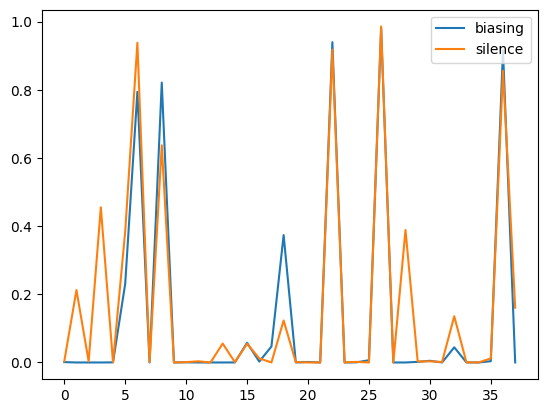

In [ ]:
print(np.mean(target_probs_biasing), np.std(target_probs_biasing), np.mean(target_probs_silence), np.std(target_probs_silence))
plt.plot(target_probs_biasing)
plt.plot(target_probs_silence)
plt.legend(['biasing', 'silence'])